In [1]:
#https://arlpy.readthedocs.io/en/latest/_static/bellhop.html
import pandas as pd
import numpy as np
import scipy as sp
from scipy import signal
import matplotlib.pyplot as plt1
import sklearn
from sklearn.preprocessing import normalize

import arlpy.uwapm as pm
import arlpy.plot as plt

pm.models()

#                name : arlpy
#   bottom_absorption : 0.1
#      bottom_density : 1600
#    bottom_roughness : 0
#   bottom_soundspeed : 1600
#               depth : 25
#        depth_interp : linear
#           frequency : 25000
#           max_angle : 80
#           min_angle : -80
#            rx_depth : 10
#            rx_range : 1000
#          soundspeed : 1500
#   soundspeed_interp : spline
#             surface : None
#      surface_interp : linear
#            tx_depth : 5
#   tx_directionality : None
#                type : 2D

['bellhop']

In [2]:
#http://www.marine-geo.org/tools/search/Files.php?data_set_uid=18936
#http://www.marine-geo.org/tools/search/Files.php?data_set_uid=18985 ['depth','temp','velocity']
#MGL1212NTMCS01 shallow
#T5_00077.EDF
shallow = pd.read_csv('T5_00077.EDF',names=['depth','temp','velocity'],header=0,delimiter='\t',skiprows=34).drop(['temp'],axis=1)
#MGL1212MCS05 deep 
#T5_00026.EDF
deep = pd.read_csv('T5_00026.EDF',names=['depth','temp','velocity'],header=0,delimiter='\t',skiprows=34).drop(['temp'],axis=1)
#MGL1212MCS07 mid
#T5_00026.EDF
mid = pd.read_csv('T5_00026.EDF',names=['depth','temp','velocity'],header=0,delimiter='\t',skiprows=34).drop(['temp'],axis=1)

In [3]:
#Define sound speed profile

#ssp = [#sound speed profile
#    [ 0.0, 1540],  # 1540 m/s at the surface
#    [10, 1530],  # 1530 m/s at 10 m depth
#    [20, 1532],  # 1532 m/s at 20 m depth
#    [25, 1533],  # 1533 m/s at 25 m depth
#    [30, 1535],   # 1535 m/s at the seabed
#    [1500, 1480]
#]
freq = 50
deep_depth = 1500
mid_depth = 500
shallow_depth = 50

#grab values from dataframe
ssp_deep = deep.values
ssp_mid = mid.values
ssp_shallow = shallow.values

#find index nearest to depth
val, i = 0, 0
while(val<deep_depth):
    i = i + 1
    val = ssp_deep[i,0]

val, j = 0, 0
while(val<mid_depth):
    j = j + 1
    val = ssp_mid[j,0]
    
val, k = 0, 0
while(val<shallow_depth):
    k = k + 1
    val = ssp_shallow[k,0]

#truncate to that
ssp_deep = ssp_deep[:i,:]
ssp_mid = ssp_mid[:j,:]
ssp_shallow = ssp_shallow[:k,:]

#step to downsample SSP
d_step = 10
s_step = 1

#downsample
ssp_deep = ssp_deep[0:-1:d_step,:]
ssp_shallow = ssp_shallow[0:-1:s_step,:]
ssp_mid = ssp_mid[0:-1:d_step,:]

#Start of SSP must be 0m
ssp_deep[0][0] = 0
ssp_shallow[0][0] = 0
ssp_mid[0][0] = 0

#replace value with final depth
ssp_deep[-1][0] = deep_depth
ssp_mid[-1][0] = mid_depth
ssp_shallow[-1][0] = shallow_depth

In [4]:
#Define bathymetry

In [5]:
#define environments
env_deep = pm.create_env2d(
    name= 'DEEP',
    depth = deep_depth,    #ocean depth
    frequency = freq,    #majority freq???
    rx_depth = 10,   #streamer depth
    rx_range = 8000, #streamer length
    tx_depth = 10,   #airgun depth
    soundspeed =  ssp_deep
)
env_mid = pm.create_env2d(
    name= 'MID',
    depth = mid_depth,    #ocean depth
    frequency = freq,    #majority freq???
    rx_depth = 10,   #streamer depth
    rx_range = 8000, #streamer length
    tx_depth = 10,   #airgun depth
    soundspeed = ssp_mid
)
env_shallow = pm.create_env2d(
    name= 'SHALLOW',
    depth = shallow_depth,    #ocean depth
    frequency = freq,    #majority freq???
    rx_depth = 10,   #streamer depth
    rx_range = 8000, #streamer length
    tx_depth = 10,   #airgun depth
    soundspeed = ssp_shallow
)

In [6]:
pm.plot_ssp(env_deep)

In [7]:
pm.plot_ssp(env_shallow)

In [8]:
#deep
#pm.print_env(env_deep)
rays = pm.compute_eigenrays(env_deep)
pm.plot_rays(rays, env=env_deep, width=900)
#print(rays)

In [9]:
#mid
rays = pm.compute_eigenrays(env_mid)
pm.plot_rays(rays, env=env_mid, width=900)

In [10]:
#shallow
rays = pm.compute_eigenrays(env_shallow)
pm.plot_rays(rays, env=env_shallow, width=900)

In [11]:
#deep
env_deep['rx_range'] = np.linspace(0, 1000, 1001)
env_deep['rx_depth'] = np.linspace(0, 30, 301)

tloss = pm.compute_transmission_loss(env_deep)
pm.plot_transmission_loss(tloss, env=env_deep, clim=[-60,-30], width=900)

#tloss = pm.compute_transmission_loss(env_deep, mode='incoherent')
#pm.plot_transmission_loss(tloss, env=env_deep, clim=[-60,-30], width=900)

In [12]:
#mid
env_mid['rx_range'] = np.linspace(0, 1000, 1001)
env_mid['rx_depth'] = np.linspace(0, 30, 301)

tloss = pm.compute_transmission_loss(env_mid)
pm.plot_transmission_loss(tloss, env=env_mid, clim=[-60,-30], width=900)

#tloss = pm.compute_transmission_loss(env_mid, mode='incoherent')
#pm.plot_transmission_loss(tloss, env=env_mid, clim=[-60,-30], width=900)

In [13]:
#shallow
env_shallow['rx_range'] = np.linspace(0, 1000, 1001)
env_shallow['rx_depth'] = np.linspace(0, 30, 301)

tloss = pm.compute_transmission_loss(env_shallow)
pm.plot_transmission_loss(tloss, env=env_shallow, clim=[-60,-30], width=900)

#print(tloss)
#tloss = pm.compute_transmission_loss(env_mid, mode='incoherent')
#pm.plot_transmission_loss(tloss, env=env_mid, clim=[-60,-30], width=900)

In [14]:
pm.plot_transmission_loss(tloss, env=env_shallow, clim=[-60,-30], width=900)

In [50]:
#Airgun waveform
#fs = 500 #resolution
#tao = 5  #decay rate
#amp = 1  #amplitude
#t = np.linspace(0,10,10*fs) 
#x = np.array(amp*np.exp(-tao*t),dtype=np.complex128)
#plt.plot(t,x)
full = sp.io.loadmat(r'C:\Users\zomege\Documents\GitHub\Machine-Learning-On-Seismic-Streamer-Data\example_shots\deep.mat')
f2 = full['Data1']
x = f2[0]
t = np.linspace(0,8191,8192)/fs

plt.plot(t,x)


In [51]:
def severalSources_h(freq, depth, ssp):
    A = np.array([2*360, 40, 2*180, 90, 120, 60, 2*220]) #relative intensity (size in cu. in.)/20, 4 strings
    A = A/np.sum(A)
    length = 8192
    #ag_depth = [0, 3, 6, 8, 10, 12, 15]#reciver depths
    
    for j in range(0,6):
        #print(j)
        env_temp = pm.create_env2d(
            name= 'temp',
            depth = depth,    
            frequency = freq,   
            rx_depth = 10,  
            rx_range = 8000, 
            tx_depth = 9,#ag_depth[j],
            soundspeed =  ssp
        )
        if j==0:
            h = np.zeros(length,dtype=np.complex128)
        #else:
        arrivals = pm.compute_arrivals(env_temp)
        amplitudes = np.array(arrivals['arrival_amplitude'])
        locs = np.rint(np.array(arrivals['time_of_arrival'])*fs)
        locs = np.array(locs,dtype=int)

        h_temp = np.zeros(length,dtype=np.complex128)
        h_temp[locs] = A[j]*amplitudes
        h = h + h_temp
    return h

Text(0.5, 1.0, 'Recieved Signal (deep)')

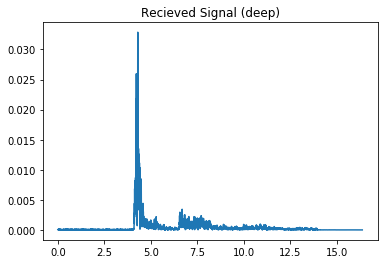

In [44]:
h_deep = severalSources_h(freq, deep_depth, ssp_deep)

#plot result
y = np.convolve(x,h_deep,mode='same')
y = np.abs(y)

plt1.plot(t,y)
plt1.title('Recieved Signal (deep)')

Text(0.5, 1.0, 'Recieved Signal (shallow)')

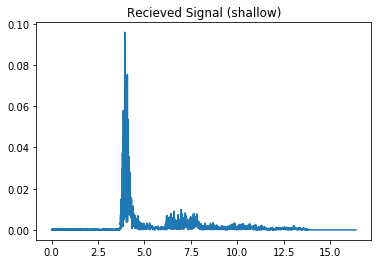

In [45]:
h_shallow = severalSources_h(freq, shallow_depth, ssp_shallow)

#plot result
y = np.convolve(x,h_shallow,mode='same')
y = np.abs(y)
plt1.plot(t,y)
plt1.title('Recieved Signal (shallow)')

Text(0.5, 1.0, 'Recieved Signal (mid)')

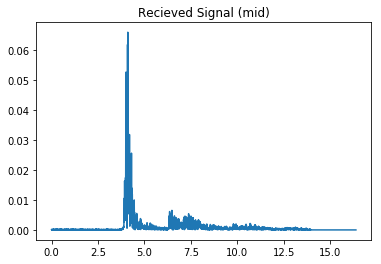

In [46]:
h_mid = severalSources_h(freq, mid_depth, ssp_mid)

#plot result
y = np.convolve(x,h_mid,mode='same')
y = np.abs(y)
plt1.plot(t,y)
plt1.title('Recieved Signal (mid)')

In [47]:
def shot_spectogram(file,index):
    Fs = 500
    full = sp.io.loadmat(file)
    f2 = full['Data1']
    y = f2[index]
    
    f, t, Sxx = signal.spectrogram(y, Fs, nfft = 256, scaling='density')
    Sx = 20*(np.log10(Sxx))
    plt1.pcolormesh(Sx)
    plt1.ylabel('Frequency [Hz]')
    plt1.xlabel('Time [sec]')
    plt1.colorbar
    plt1.show()

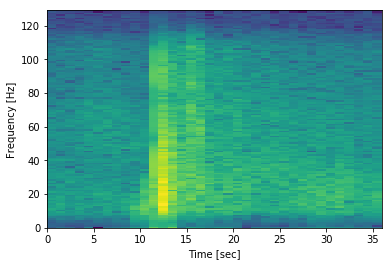

In [49]:
shot_spectogram(r'C:\Users\zomege\Documents\GitHub\Machine-Learning-On-Seismic-Streamer-Data\example_shots\shallow.mat',20)

In [ ]:
shot_spectogram(r'C:\Users\zomege\Documents\GitHub\Machine-Learning-On-Seismic-Streamer-Data\example_shots\shallow.mat',400)

In [ ]:
shot_spectogram(r'C:\Users\zomege\Documents\GitHub\Machine-Learning-On-Seismic-Streamer-Data\example_shots\deep.mat',20)

In [ ]:
shot_spectogram(r'C:\Users\zomege\Documents\GitHub\Machine-Learning-On-Seismic-Streamer-Data\example_shots\deep.mat',400)